In [1]:
from sound_processor import Denoiser, DownSampler
from scipy.io import wavfile
import IPython
import matplotlib.pyplot as plt
import numpy as np

In [2]:
denoiser = Denoiser()
downsampler = DownSampler(8000)

In [3]:
wav_loc = "0001.wav"
rate, data = wavfile.read(wav_loc)

In [4]:
IPython.display.Audio(data=data.T, rate=rate)

In [5]:
noise_loc = 'reduced_noise.wav'
nrate, ndata = wavfile.read(noise_loc)

In [6]:
IPython.display.Audio(data=ndata.T, rate=nrate)

In [7]:
downsampled_data = downsampler.downsample(data.T, rate)
downsampled_noise = downsampler.downsample(ndata.T, nrate)

In [8]:
IPython.display.Audio(data=downsampled_data, rate=8000)

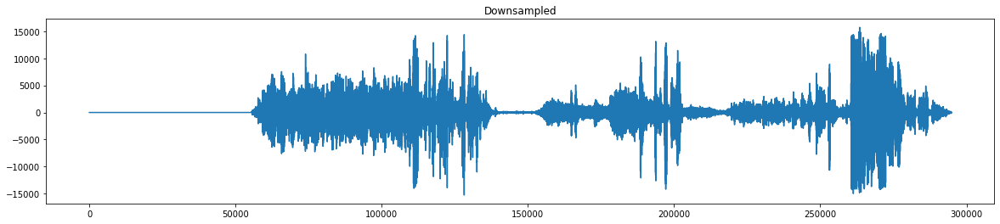

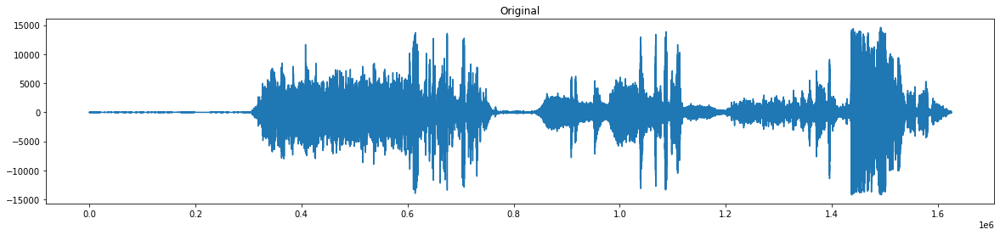

In [9]:
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Downsampled')
ax.plot(downsampled_data)
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Original')
ax.plot(data.T[0].astype(np.float))
plt.show()

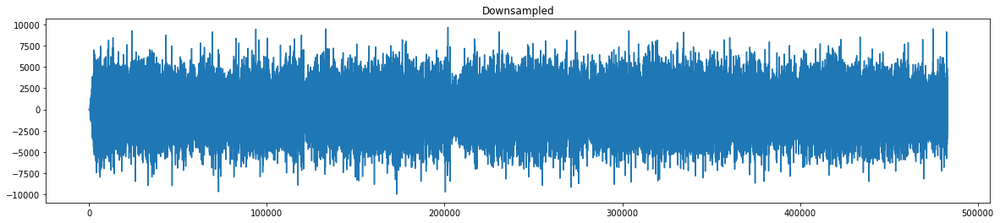

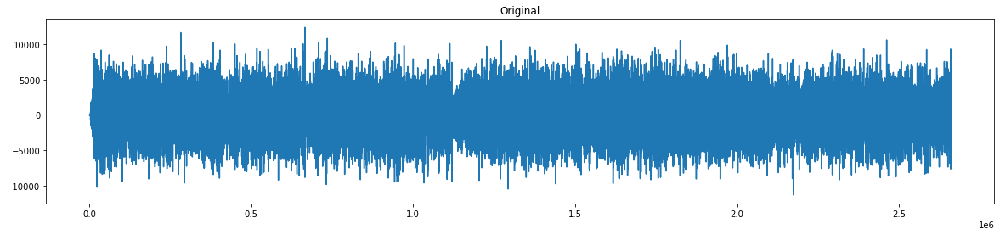

In [10]:
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Downsampled')
ax.plot(downsampled_noise)
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Original')
ax.plot(ndata.T[0].astype(np.float))
plt.show()

In [11]:
denoised_data = denoiser.denoise(data.T, ndata.T)

In [12]:
IPython.display.Audio(data=denoised_data, rate=rate)

In [13]:
IPython.display.Audio(data=downsampled_noise, rate=8000)

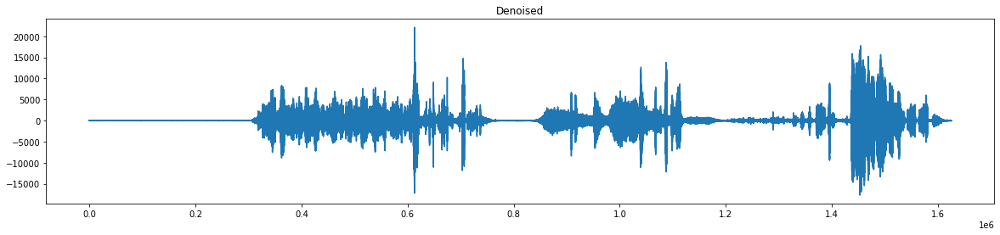

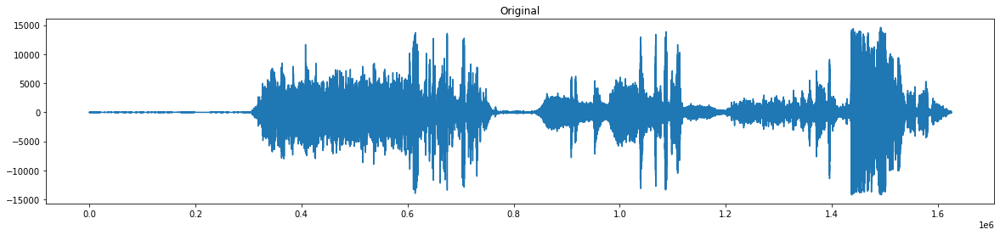

In [14]:
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Denoised')
ax.plot(denoised_data)
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Original')
ax.plot(data.T[0].astype(np.float))
plt.show()

In [15]:
downsampled_denoised_data = denoiser.denoise(downsampled_data, downsampled_noise)

In [16]:
IPython.display.Audio(data=downsampled_denoised_data, rate=8000)

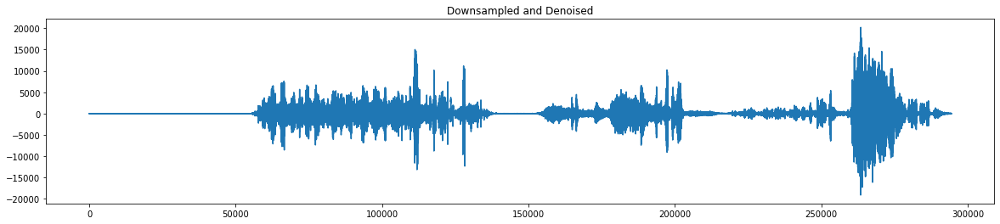

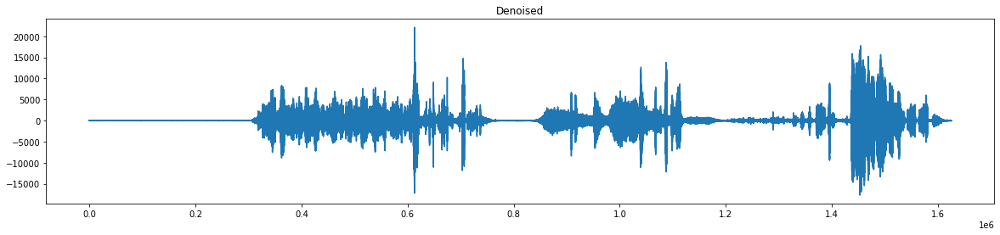

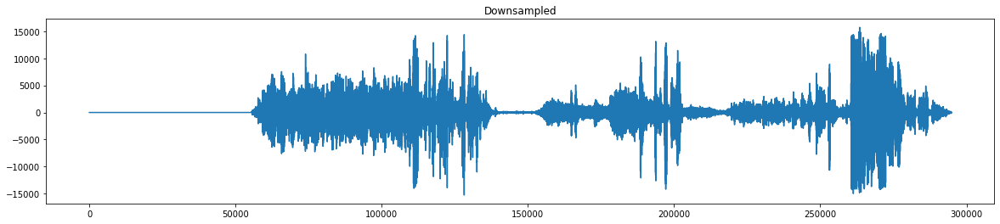

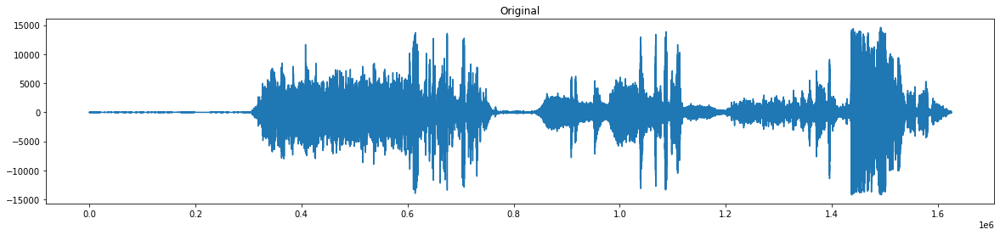

In [17]:
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Downsampled and Denoised')
ax.plot(downsampled_denoised_data)
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Denoised')
ax.plot(denoised_data)
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Downsampled')
ax.plot(downsampled_data)
fig, ax = plt.subplots(figsize=(20,4))
plt.title('Original')
ax.plot(data.T[0].astype(np.float))
plt.show()